In [1]:
import netCDF4
from netCDF4 import Dataset
from pyproj import CRS, Transformer
import numpy as np
import time
import os 
import pandas as pd
import cartopy
import matplotlib.pyplot as plt
from netCDF4 import Dataset as netcdf_dataset
import numpy as np
import pyproj
from pyproj import CRS, Transformer
from cartopy import config
import cartopy.crs as ccrs
import matplotlib
import matplotlib.dates as mdates
import matplotlib.path as mpath
import datetime as dt
import matplotlib.colors as colors
cm = 1/2.54
def toYearFraction(date):
    def sinceEpoch(date): # returns seconds since epoch
        return time.mktime(date.timetuple())
    s = sinceEpoch

    year = date.year
    startOfThisYear = dt.datetime(year=year, month=1, day=1)
    startOfNextYear = dt.datetime(year=year+1, month=1, day=1)

    yearElapsed = s(date) - s(startOfThisYear)
    yearDuration = s(startOfNextYear) - s(startOfThisYear)
    fraction = yearElapsed/yearDuration

    return date.year + fraction

def ps2ll(x, y):
    """
    Transform coordinates from Antarctic Polar Stereograph
    to geodetic (lon, lat) coordinates
    lon, lat = ps2ll(x, y)
    """
    crs_ll = CRS("EPSG:4326")
    crs_xy = CRS("EPSG:3031")
    xy_to_ll = Transformer.from_crs(crs_xy, crs_ll, always_xy = True)
    lon, lat = xy_to_ll.transform(x, y)
    return lon, lat

def ll2ps(lon, lat):
    """
    Transform coordinates from geodetic coordinates (lon, lat)
    to Antarctic Polar Stereograph coordinates (x, y)
    x, y = ll2ps(lon, lat)
    """
    crs_ll = CRS("EPSG:4326")
    crs_xy = CRS("EPSG:3031")
    ll_to_xy = Transformer.from_crs(crs_ll, crs_xy, always_xy = True)
    x, y = ll_to_xy.transform(lon, lat)
    return x, y
def geo_idx(dd, dd_array):
    """
     search for nearest decimal degree in an array of decimal degrees and return the index.
     np.argmin returns the indices of minium value along an axis.
     so subtract dd from all values in dd_array, take absolute value and find index of minium.
    """
    geo_idx = (np.abs(dd_array - dd)).argmin()
    return geo_idx

In [51]:

f1= Dataset("data/SEA_SURFACE_HEIGHT_ALT_GRIDS_L4_2SATS_5DAY_6THDEG_V_JPL1812/ssh_grids_v1812_2018122512.nc")
long_idx = geo_idx(303.75, f1.variables['Longitude'][:])
lat_idx = geo_idx(53.75, f1.variables['Latitude'][:])
print(f1)
(f1.variables['SLA'][:,long_idx,lat_idx].tolist())

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF3_CLASSIC data model, file format NETCDF3):
    Conventions: CF-1.6
    ncei_template_version: NCEI_NetCDF_Grid_Template_v2.0
    Institution: Jet Propulsion Laboratory
    geospatial_lat_min: -79.916664
    geospatial_lat_max: 79.916664
    geospatial_lon_min: 0.083333336
    geospatial_lon_max: 359.91666
    time_coverage_start: 2018-12-25
    time_coverage_end: 2018-12-25
    date_created: 2019-11-25T20:40:48.502428
    version_number: 1812
    summary: Sea level anomaly grids from altimeter data using Kriging interpolation, which gives best linear prediction based upon prior knowledge of covariance. 
    title: Sea Level Anormaly Estimate based on Altimeter Data
    dimensions(sizes): Time(1), Longitude(2160), Latitude(960), nv(2)
    variables(dimensions): float32 Lon_bounds(Longitude, nv), float32 Longitude(Longitude), float32 Lat_bounds(Latitude, nv), float32 Latitude(Latitude), float32 Time(Time), float32 Time_bounds(Time, nv

[0.0736747458577156]

In [21]:

f1= Dataset("data/SEA_SURFACE_HEIGHT_ALT_GRIDS_L4_2SATS_5DAY_6THDEG_V_JPL1812/ssh_grids_v1812_2018122512.nc")
f1.variables['SLA'][0,:,:].tolist()

[[None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  None,
  0.07033944129943848,
  0.07083211094141006,
  0.07126549631357193,
  0.0723208487033844,
  0.0738115981221199,
  0.07588887214660645,
  0.07808267325162888,
  0.0792762041091919,
  0.07790208607912064,
  0.0706741139292717,
  0.06476502865552902,
  0.06050539016723633,
  0.05879904702305794,
  0.05838816985487938,
  0.059021901339292526,
  0.060881130397319794,
  0.06298476457595825,
  0.06508208811283112,
  0.06645708531141281,
  0.06168356537818909,
  0.0567382499

In [4]:
#burayı yeni ekledim  ssh_grids_v1812_1992120612.nc
f1= Dataset("ful/ssh_grids_v1812_1992123112.nc")
f2= Dataset("ful/ssh_grids_v1812_2019012412.nc")
list1 = np.array(f1.variables['SLA'][0,:,:].tolist())
list2 = np.array(f2.variables['SLA'][0,:,:].tolist())

for i in range(len(list1)):
    for j in range(len(list1[i])):
        if list1[i][j] == None: 
            list1[i][j]=np.nan
        else: 
            list1[i][j]=list1[i][j]
for i in range(len(list2)):
    for j in range(len(list2[i])):
        if list2[i][j] == None: 
            list2[i][j]=np.nan
        else: 
            list2[i][j]=list2[i][j]
subs = []
for i in range(len(list1)):
    sub=[]
    for j in range(len(list1[0])):
        sub.append((list2[i][j]-list1[i][j])) 
    subs.append(sub)
f1

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF3_CLASSIC data model, file format NETCDF3):
    Conventions: CF-1.6
    ncei_template_version: NCEI_NetCDF_Grid_Template_v2.0
    Institution: Jet Propulsion Laboratory
    geospatial_lat_min: -79.916664
    geospatial_lat_max: 79.916664
    geospatial_lon_min: 0.083333336
    geospatial_lon_max: 359.91666
    time_coverage_start: 1992-12-31
    time_coverage_end: 1992-12-31
    date_created: 2019-02-11T20:20:17.197465
    version_number: 1812
    summary: Sea level anomaly grids from altimeter data using Kriging interpolation, which gives best linear prediction based upon prior knowledge of covariance. 
    title: Sea Level Anormaly Estimate based on Altimeter Data
    dimensions(sizes): Time(1), Longitude(2160), Latitude(960), nv(2)
    variables(dimensions): float32 Lon_bounds(Longitude, nv), float32 Longitude(Longitude), float32 Lat_bounds(Latitude, nv), float32 Latitude(Latitude), float32 Time(Time), float32 Time_bounds(Time, nv

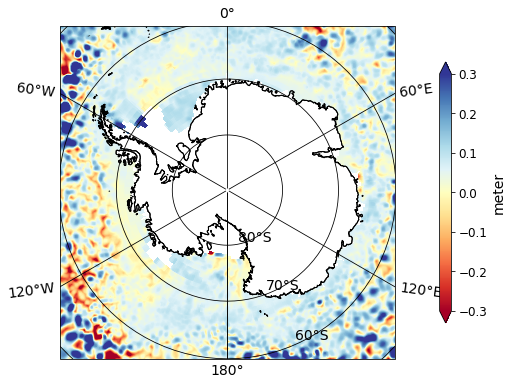

In [5]:
#burayı yeni ekledim
data_crs = ccrs.PlateCarree()
sst = np.array(subs)
sst = sst.T
lats = np.array(f1.variables['Latitude'][:].tolist())
lons = np.array(f1.variables['Longitude'][:].tolist())

fig = plt.figure(figsize=(8,8))
#fig.suptitle('MEaSUREs Gridded Sea Surface Height Anomalies 2019-1992', fontsize=20)

matplotlib.rcParams.update({'font.size': 14})
#x, y = transform_coord(4326, 3996, lon, lat)
central_lon, central_lat = 0, -90
extent = [-180, 180, -90, -60]

ax = plt.axes(projection=ccrs.SouthPolarStereo(central_lon, central_lat))
ax.set_extent(extent, ccrs.PlateCarree())


ax.coastlines(resolution='10m')

levels = np.linspace(-0.3,0.3,256)
bounds=np.arange(-8,3,1)
#norm = colors.BoundaryNorm(boundaries=bounds, ncolors=256)
plot1 = plt.contourf(lons, lats, sst,256,levels=levels,  cmap="RdYlBu",
             transform=data_crs, extend ="both") #

cbar = fig.colorbar(plot1,ax=ax,pad=0.1,shrink=0.6)
cbar.set_label("meter",fontsize=14)
cbar.set_ticks(np.arange(-0.3,0.4,0.1))
cbar.ax.tick_params(labelsize=12) 

#ax.add_feature(cartopy.feature.GLACIER)
ax.coastlines()
ax.gridlines(draw_labels=True,color="black")
plt.savefig("ssha.png", bbox_inches = 'tight', dpi=300, pad_inches = 0.02)

In [5]:
f1= Dataset("ful/ssh_grids_v1812_2010012112.nc")
f2= Dataset("ful/ssh_grids_v1812_2019012412.nc")
list1 = np.array(f1.variables['SLA'][0,:,:].tolist())
list2 = np.array(f2.variables['SLA'][0,:,:].tolist())

for i in range(len(list1)):
    for j in range(len(list1[i])):
        if list1[i][j] == None: 
            list1[i][j]=np.nan
        else: 
            list1[i][j]=list1[i][j]
for i in range(len(list2)):
    for j in range(len(list2[i])):
        if list2[i][j] == None: 
            list2[i][j]=np.nan
        else: 
            list2[i][j]=list2[i][j]
subs = []
for i in range(len(list1)):
    sub=[]
    for j in range(len(list1[0])):
        sub.append((list2[i][j]-list1[i][j])) 
    subs.append(sub)
f1

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF3_CLASSIC data model, file format NETCDF3):
    Conventions: CF-1.6
    ncei_template_version: NCEI_NetCDF_Grid_Template_v2.0
    Institution: Jet Propulsion Laboratory
    geospatial_lat_min: -79.916664
    geospatial_lat_max: 79.916664
    geospatial_lon_min: 0.083333336
    geospatial_lon_max: 359.91666
    time_coverage_start: 2010-01-21
    time_coverage_end: 2010-01-21
    date_created: 2019-02-11T20:41:30.466360
    version_number: 1812
    summary: Sea level anomaly grids from altimeter data using Kriging interpolation, which gives best linear prediction based upon prior knowledge of covariance. 
    title: Sea Level Anormaly Estimate based on Altimeter Data
    dimensions(sizes): Time(1), Longitude(2160), Latitude(960), nv(2)
    variables(dimensions): float32 Lon_bounds(Longitude, nv), float32 Longitude(Longitude), float32 Lat_bounds(Latitude, nv), float32 Latitude(Latitude), float32 Time(Time), float32 Time_bounds(Time, nv

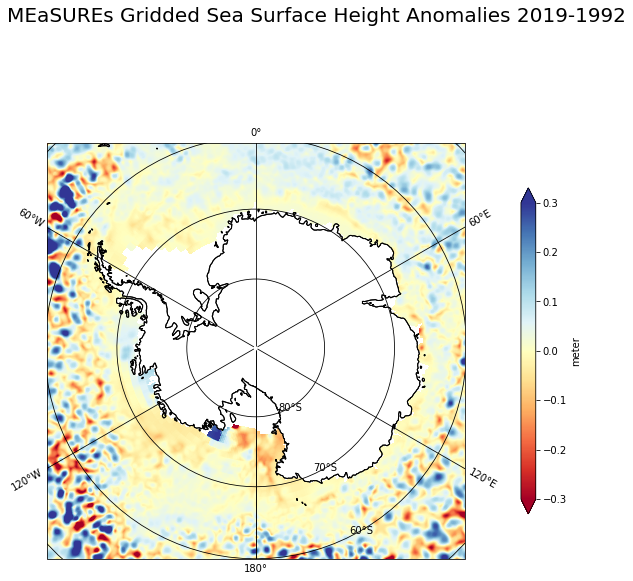

In [33]:
data_crs = ccrs.PlateCarree()
sst = np.array(subs)
sst = sst.T
lats = np.array(f1.variables['Latitude'][:].tolist())
lons = np.array(f1.variables['Longitude'][:].tolist())

fig = plt.figure(figsize=(10,10))
fig.suptitle('MEaSUREs Gridded Sea Surface Height Anomalies 2019-1992', fontsize=20)

#x, y = transform_coord(4326, 3996, lon, lat)
central_lon, central_lat = 0, -90
extent = [-180, 180, -90, -60]

ax = plt.axes(projection=ccrs.SouthPolarStereo(central_lon, central_lat))
ax.set_extent(extent, ccrs.PlateCarree())


ax.coastlines(resolution='50m')

levels = np.linspace(-0.3,0.3,256)
bounds=np.arange(-8,3,1)
#norm = colors.BoundaryNorm(boundaries=bounds, ncolors=256)
plot1 = plt.contourf(lons, lats, sst,256,levels=levels,  cmap="RdYlBu",
             transform=data_crs, extend ="both") #

cbar = fig.colorbar(plot1,ax=ax,pad=0.1,shrink=0.6)
cbar.set_label("meter")
cbar.set_ticks(np.arange(-0.3,0.4,0.1))

#ax.add_feature(cartopy.feature.GLACIER)
ax.coastlines()
ax.gridlines(draw_labels=True,color="black")
plt.show()

faraday

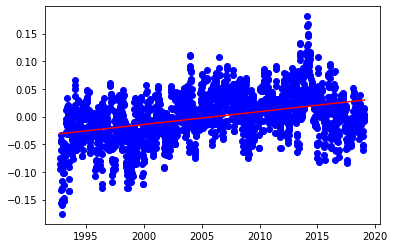

Trend :2.32mm ± 0.12mm


In [4]:
import datetime as dt
flist = sorted([f for f in os.listdir("ful/") if f.endswith('.nc')])
date = []
sla=[]
for i in range(len(flist)):
    f= Dataset("ful/"+flist[i]) 
    long_idx = geo_idx(360-71.8, f.variables['Longitude'][:])
    lat_idx = geo_idx(-65, f.variables['Latitude'][:])
    sla.append(f.variables['SLA'][:,long_idx,lat_idx].tolist()[0])
    dd = dt.timedelta(days = f.variables['Time'][0].tolist())
    date.append((dt.datetime.strptime("1985-01-01","%Y-%m-%d")+dd))
# 360-64.267 -65.25
for i in range(len(sla)):
    if sla[i] == None: 
        sla[i]=np.nan
    else: 
        sla[i]=sla[i]

datedec = []
for i in range(len(date)):
    datedec.append(toYearFraction(date[i]))

from scipy import stats
df = pd.DataFrame()
df["year"] = pd.DatetimeIndex(pd.Series(date)).normalize().year
df["month"] = pd.DatetimeIndex(pd.Series(date)).normalize().month
df["day"] = pd.DatetimeIndex(pd.Series(date)).normalize().day
df["sla"] = pd.Series(sla)
df = df.fillna(method="bfill")
# df = df.dropna()
df.isna().values.any()
x = np.asarray(df.drop(columns=["sla"]))
y = np.asarray(df["sla"])
df.to_excel("kalman.xlsx")
gradient, intercept, r_value, p_value, std_err = stats.linregress(datedec,y)
mn=np.min(datedec)
mx=np.max(datedec)
x1=np.linspace(mn,mx,1922)
y1=gradient*x1+intercept
plt.plot(datedec,y,'ob')
plt.plot(x1,y1,'-r')
plt.show()
print(f"Trend :{round(gradient*1000,2)}mm \u00B1 {round(std_err*1000,2)}mm")


In [77]:
def weighted_avg_and_std(values, weights):
    """
    Return the weighted average and standard deviation.

    values, weights -- Numpy ndarrays with the same shape.
    """
    average = np.average(values, weights=weights)
    # Fast and numerically precise:
    variance = np.average((values-average)**2, weights=weights)
    return (average, np.sqrt(variance))

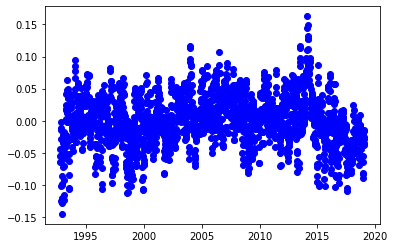

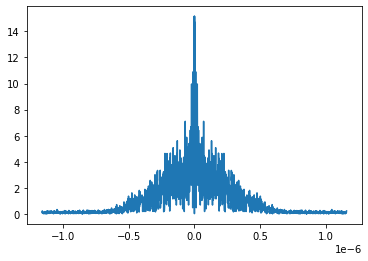

3.244931279512235e-07 -1.1574074074074e-06 1.1562030292519291e-06


In [78]:
fs = 2.3148148148148e-6 
data = df["sla"]-y1
plt.plot(datedec,data,'ob')
plt.show()
data_fft = np.fft.fft(data)
data_freq = np.fft.fftfreq(len(data), 1/fs)
plt.plot(np.fft.fftshift(data_freq), np.fft.fftshift(np.abs(data_fft)))
plt.show()
ave, std = (weighted_avg_and_std(np.fft.fftshift(data_freq),np.fft.fftshift(np.abs(data_fft))))
print(std,min(np.fft.fftshift(data_freq)),max(np.fft.fftshift(data_freq)))

6.48986255902447e-07


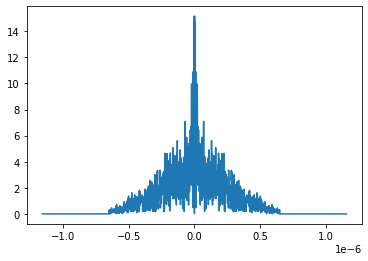

In [79]:
filt = np.ones(len(data))
print(2*std )
filt_cutoff = 2*std #0.1e-6
filt[np.abs(data_freq) > filt_cutoff] = 0
data_fft_filt = data_fft * filt
plt.plot(np.fft.fftshift(data_freq), np.fft.fftshift(np.abs(data_fft_filt)))

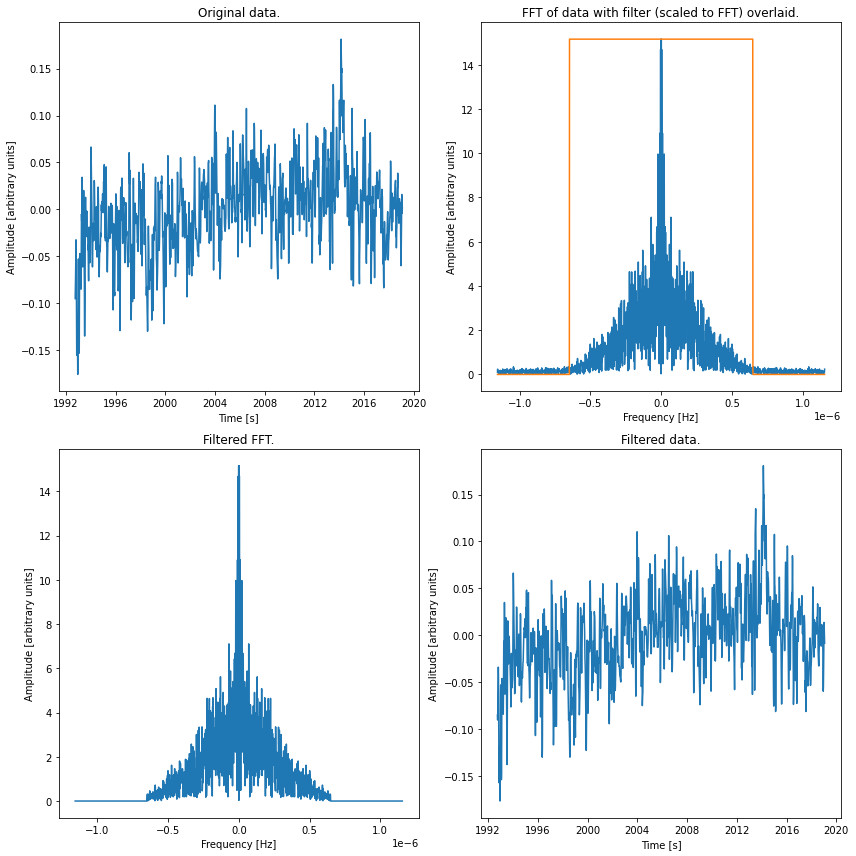

In [80]:
fig, ax = plt.subplots(2, 2, figsize=(12, 12))
ax[0][0].plot(date, df["sla"])
ax[0][0].set_title('Original data.')
ax[0][0].set_xlabel('Time [s]')
ax[0][0].set_ylabel('Amplitude [arbitrary units]')

ax[0][1].plot(np.fft.fftshift(data_freq), np.fft.fftshift(np.abs(data_fft)))
ax[0][1].plot(np.fft.fftshift(data_freq),
              np.fft.fftshift(filt) * np.max(np.abs(data_fft)))
ax[0][1].set_title('FFT of data with filter (scaled to FFT) overlaid.')
ax[0][1].set_xlabel('Frequency [Hz]')
ax[0][1].set_ylabel('Amplitude [arbitrary units]')

ax[1][0].plot(np.fft.fftshift(data_freq),
              np.fft.fftshift(np.abs(data_fft_filt)))
ax[1][0].set_title('Filtered FFT.')
ax[1][0].set_xlabel('Frequency [Hz]')
ax[1][0].set_ylabel('Amplitude [arbitrary units]')

ax[1][1].plot(date, data_clean)
ax[1][1].set_title('Filtered data.')
ax[1][1].set_xlabel('Time [s]')
ax[1][1].set_ylabel('Amplitude [arbitrary units]')

fig.tight_layout()
plt.savefig("fourier.jpg", bbox_inches = 'tight', dpi=300, pad_inches = 0.02)

0.044256455113820876 0.04419011992476484


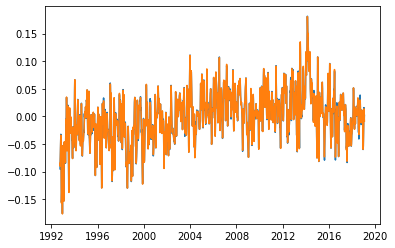

In [81]:

data_clean = np.real(np.fft.ifft(data_fft_filt)) +y1
print(np.std(df["sla"]),np.std(data_clean))

plt.plot(date, df["sla"])
plt.plot(date, data_clean)


-0.09512076526880264 -0.08508987269328891


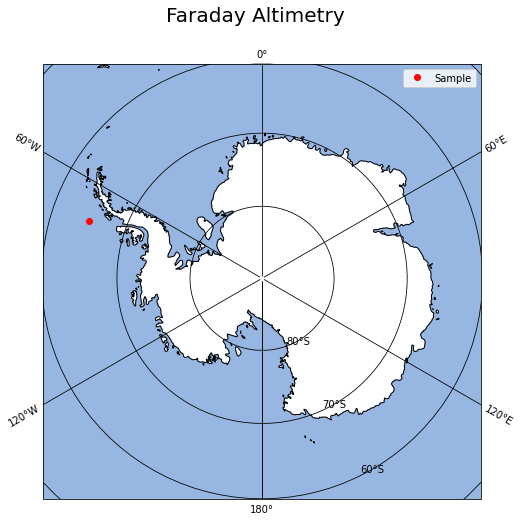

Trend :2.32mm ± 0.12mm


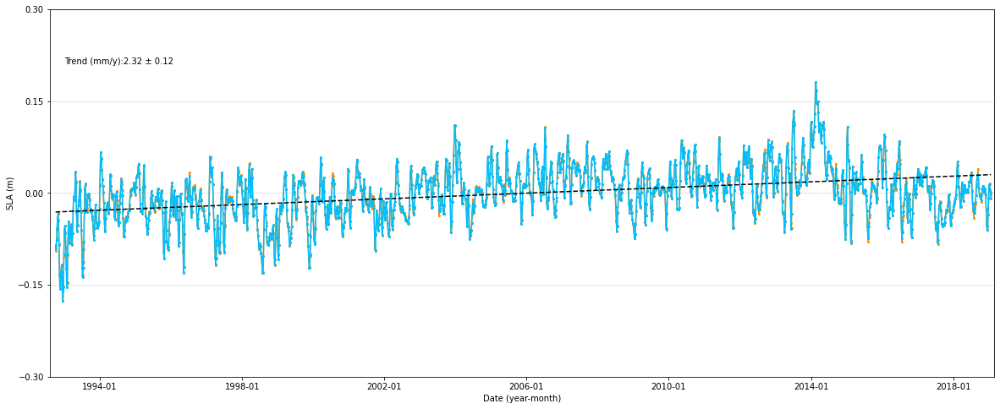

In [82]:
print(df["sla"][0],data_clean[0])

from datetime import datetime
fig = plt.figure(figsize=(8,8))
ax1 = plt.subplot( projection=ccrs.SouthPolarStereo())
fig.suptitle('Faraday Altimetry', fontsize=20)
central_lon, central_lat = 0, -90
extent = [-180, 180, -90, -60]
#central_lon, central_lat = -100, -75
#extent = [-120, -60, -80, -70]
ax1 = plt.axes(projection=ccrs.SouthPolarStereo(central_lon, central_lat))
ax1.set_extent(extent, ccrs.PlateCarree())
ax1.gridlines(draw_labels=True,color="black")
ax1.coastlines(resolution='50m')
ax1.add_feature(cartopy.feature.LAND,color="w")
ax1.add_feature(cartopy.feature.OCEAN)
ax1.plot(-71.8, -65, 'o',markersize=6, color="r", label="Sample",transform=ccrs.PlateCarree())
# -108, -73.5 
ax1.set_xlabel('lon (m)') # x (m)
ax1.set_ylabel('lat (m)')#y (m)
ax1.legend()
plt.show()
fig, ax = plt.subplots(figsize=(20,8))
ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))
ax.xaxis.set_major_locator(mdates.MonthLocator(interval = 48))

#ax.set_xticks(np.arange(len(date)))
#ax.set_xticklabels(date,rotation=90)

ax.plot(date,sla,marker="o",markersize=2,color="darkorange") #linestyle="", 
ax.plot(date,data_clean,marker="o", markersize=2,color="deepskyblue")
ax.plot(date, y1, '--k')

ax.set_ylim(-0.3,0.3)
ax.set_yticks(np.arange(-0.3,0.31,0.15))
ax.set_xlim(date[0]-dt.timedelta(days=60), date[-1]+dt.timedelta(days=30))

ax.set_ylabel("SLA (m)")
ax.set_xlabel("Date (year-month)")
ax.grid(axis='y',linestyle='--', linewidth=0.5)
ax.text(datetime.strptime("1993-01","%Y-%m"),0.21,f"Trend (mm/y):{round(gradient*1000,2)} \u00B1 {round(std_err*1000,2)}",fontsize = 10)


plt.savefig("faraday_ssha.png", bbox_inches = 'tight', dpi=300, pad_inches = 0.02)

print(f"Trend :{round(gradient*1000,2)}mm \u00B1 {round(std_err*1000,2)}mm")
